<div id="image">
<img src="https://www.imt-atlantique.fr/sites/default/files/logo_mt_0_0.png" WIDTH=280 HEIGHT=280>
</div>
<div id="subject">
<CENTER>
</br>


<font size="5"></br> Mini project : Parallel Computing in Julia </font></br></div>
</CENTER>
<CENTER>
<font size="4"> ABID Ghazi & DAMMAK Iyed & SRIDI Chadha </br></font></br></div>
</CENTER>
<CENTER>
</CENTER>



##### Problem definition 

The model we are using to decompose the image into the sum of the contributions of the endmembers is:

\begin{equation*}
\mathbf{X} = \mathbf{S}\mathbf{A} + \mathbf{E} 
\end{equation*}

 $\mathbf{X}\in \mathbb{R}^{L\times N}$ : data matrix
 
 $\mathbf{S}\in \mathbb{R}^{L\times P}$ : endmember matrix
 
 $\mathbf{A}\in \mathbb{R}^{P\times N}$ : abundance matrix
 
 $\mathbf{E}\in \mathbb{R}^{L\times N}$ : additive noise matrix
 
 where $L$ is the number of spectral bands, $P$ is the number of materials, and $N$ is the number of pixels
 
 The hyperspectral image is represented as a matrix with $N$ pixels, so the first thing to do is to reshape the image to a big matrix.

We can try and estimate the abundance matrix using a least squares formulation:

\begin{equation*}
\hat{A} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2}||\mathbf{X}-\mathbf{SA}||_{F}^{2} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2} \sum_{i=1}^{N} ||\mathbf{x}_{n}-\mathbf{S}\mathbf{a}_{n}||_{2}^{2}
\end{equation*}

where $\mathbf{1}_{.}$ is a vector of ones whose size is given in index 

Choose an algorithm to solve the optimization problem, and implement it both in a serial version and a version parallelized across the pixels.

### I. Import image and defining problem parameters

#### 1. Import librairies

In [2]:
using Distributed
@everywhere using LinearAlgebra
@everywhere using Plots
@everywhere using ProgressMeter
@everywhere using Dates
@everywhere using MAT
@everywhere using Images



#### 2. Load the image

In [3]:
pyplot()

file = matopen("project_data.mat")
img = read(file, "im")
sources = read(file,"sources")
rgb = read(file,"rgb")
close(file)

#### 3. plot image and endmembers

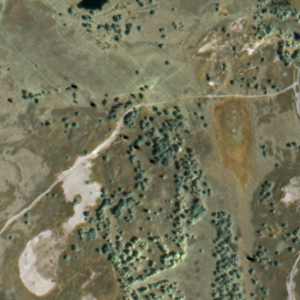

In [28]:
# visualize data in rgb (using bands 67,109,141 as th RGB channels)
p1 = colorview(RGB,permutedims(rgb,(3,1,2))) # convert 3d array to the image format used by julia

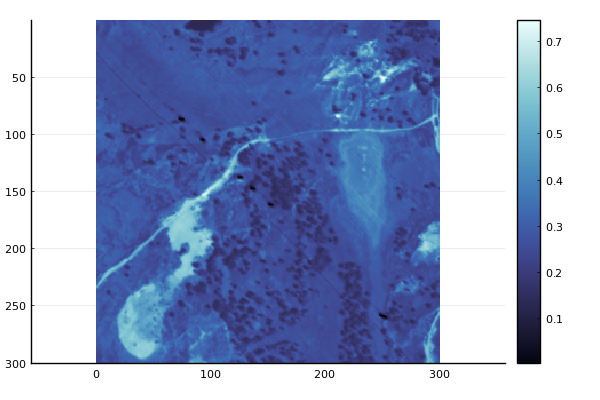

In [ ]:
#visualize a spectral band on its own
p2 = heatmap(img[:,:,150],aspect_ratio=1, yflip = true,c=:ice)

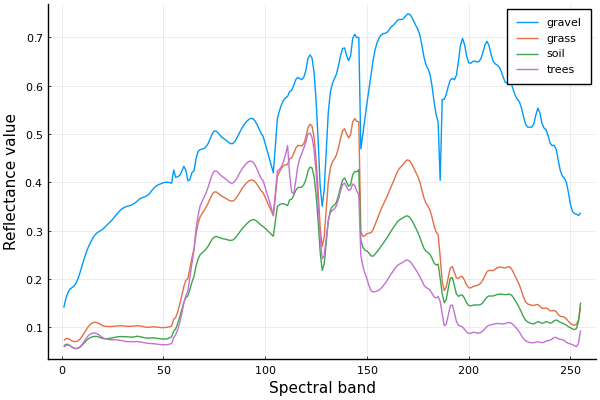

In [ ]:
# visualize the endmembers to be used

plot(sources[:,1],label = "gravel")
plot!(sources[:,2],label = "grass")
plot!(sources[:,3],label = "soil")
plot!(sources[:,4],label = "trees")
xlabel!("Spectral band")
ylabel!("Reflectance value")

#### 4. Defining problem parameters 

In [4]:
@everywhere function define_N_L_X(img)
    # N and L 
    size_img = size(img)[1]
    N = size_img^2
    L = size(img)[3]
    # X 
    X = ones((L,N))
    for i in 1:size_img
        for j in 1:size_img
            X[ : ,(i - 1 )*size_img + j] = img[i,j,:]  
        end
    end
    return N , L , X
end

@everywhere function initialize_A(P ,N)
    A = ones(P,N)/P
    for i in 1:N
        K = rand(10:100)
        R = rand(0:K, P)
        Q = sum(R)
        if (Q!=0)
            A[:,i] = R/Q
        end;
    end
    return A
end


In [5]:
# Defining the problem parameters 
img_full = copy(img);
img_small = img[1:100,1:100,:]; # use a small crop of the image first
S = sources
P = size(sources)[2]
Lipschitz = opnorm(S' * S)

# N , L and X 
N_s , L_s , X_s = define_N_L_X(img_small)
N_f , L_f , X_f = define_N_L_X(img_full)

# Create A_init
A_init_s =  initialize_A(P ,N_s);
A_init_f =  initialize_A(P ,N_f);



### II. Implementation of Core functions

#### 1. Simplex Projection Algorithm




The Simplex projection algorithm projects a vector \( x \) in the Euclidean space onto the unit simplex. The algorithm is as follows:

$$
\text{Input: } x \in \mathbb{R}^n
$$

$$
\text{Output: } p \in \mathbb{R}^n \text{, the projected vector onto the unit simplex.}
$$


1. **Sort** the components of \( x \) in descending order to obtain \( u \):

$$
u = \text{sort}(x)[::-1]
$$

2. Compute the cumulative sum of \( u - 1 \):

$$
\text{cumsum}_u = \text{cumsum}(u) - 1
$$

3. Find the **value** \($\rho$ ):

$$
\rho = \max \left\{ i : u_i > \frac{\text{cumsum}_u[i]}{i+1} \right\}
$$

4. Compute the threshold \( $\theta$ \):

$$
\theta = \frac{\text{cumsum}_u[\rho]}{\rho+1}
$$

5. **Project** the vector \( x \) onto the simplex by applying the threshold ( $\theta$):

$$
p = \max(x - \theta, 0)
$$



---

This algorithm calculates the projection of a vector 
𝑥
 onto the unit simplex, ensuring that the result is constrained to be non-negative and that the sum of the elements equals 1.


In [6]:
@everywhere function projection_matrix(B, s)
    # Initialize A1
    A1 = ones(size(B))
    if (length(size(A1))>1)
        for i in 1:size(B)[2]
            A1[:,i] = projection(B[:,i] , s)
        end
    else 
        A1 = projection(B, s)
    end
    
    return A1
end

        
@everywhere function projection(B, s)
    # Initialize
    X = B
    n = length(X)
    # Sort in descending order
    X = sort(X, rev=true)
    # Calculate the cumulative sum excess
    Sc = [(sum(X[1:j]) - 1)/j for j in 1:n]

    # Calculate the threshold theta 
    θ = Sc[n]
    for k in 1:n
        if (X[k] - Sc[k]) <= 0 
            θ = Sc[k]
            break ;
        end
    end
    
    # Apply projection
    return  [max(B[k] - θ, 0) for k in 1:n]
   

end



#### 2. Function $f$ and $\nabla f$





$$\dfrac{\partial f}{\partial A } = -S^{T}(X - SA)$$

In [7]:
@everywhere function ∇f(X,S,A)
    return S' * (S*A - X)
end

@everywhere function f(X,S,A)
    return 0.5*norm(X - S*A)^2
end      
    


#### 3 . GPFK

In [8]:
@everywhere function GPFK(X,S,f,∇f,ϵ,nb_iter_max ,A_init , α , progress , max_time )

    # Initialize variables
    A = A_init
    f_values = [f(X,S,A)]
    conv_values =[norm(A_init)]
    start_time = now()
    #max_time = max_time *1000

    for i in 1:nb_iter_max
        # Perform gradient descent step
        B = A - α *  ∇f(X,S,A)
        
        # Project onto the simplexe
        A1 = projection_matrix(B,1)

        # Update variables
        distance = norm(A1-A)
        A = A1
        current_f = f(X,S,A)
        push!(f_values, current_f)

        # Check for convergence
        elapsed_time = now() - start_time
        if norm(distance) < ϵ   || (Millisecond(elapsed_time.value) > Millisecond(max_time))
            return i , A1 , f_values , conv_values
        end

        # Log progress every 10%
        if (progress) && (i%(nb_iter_max ÷ 10) == 0) 
            println("Iteration : ",i, " | f(A) = ", current_f)
        end
    end 
    
    return nb_iter_max , A , f_values 

end

        

### III. Algorithm Versions and Comparisons

##### Convergence Thresholds Selection

After several tests, we selected convergence thresholds that allow execution within a reasonable time. The chosen values are as follows:

- **Small matrix:**
  - $ \epsilon_{\text{mat\_s}} = 0.02 $
  - $ \epsilon_{\text{col\_s}} = \frac{\epsilon_{\text{mat\_s}}}{\sqrt{N_s}} $

- **Large matrix:**
  - $ \epsilon_{\text{mat\_f}} = 0.2 $
  - $ \epsilon_{\text{col\_f}} = \frac{\epsilon_{\text{mat\_f}}}{\sqrt{N_f}} $

The relationship between the thresholds for the large and small matrices is based on their respective dimensions:
- The large matrix is $ 300 \times 300 $, while the small matrix is $ 100 \times 100 $.
- This difference in size justifies the scaling factor applied to the convergence thresholds, ensuring comparable criteria across matrices of different dimensions.


In [11]:
ϵ_mat_s = 0.033
ϵ_col_s = ϵ_mat_s/sqrt(N_s)

ϵ_mat_f = 0.3
ϵ_col_f = ϵ_mat_f/sqrt(N_f)



0.001

#### 1.  Global Implementation

##### Small Image

In [79]:
nb_iter_max = 1000
α = 2/Lipschitz
#maxtime (Millisecond)
max_time = 5*60*1000
display_progress = true 


@time begin
    nb_iter , A_opt ,f_values  = GPFK(X_s,S,f,∇f,ϵ_mat_s,nb_iter_max ,A_init_s , α , display_progress , max_time)
end


Iteration : 100 | f(A) = 1715.505837257664
Iteration : 200 | f(A) = 1519.1569916419057
Iteration : 300 | f(A) = 1474.6978656687777
Iteration : 400 | f(A) = 1459.0060758544973
Iteration : 500 | f(A) = 1454.4730504752597
Iteration : 600 | f(A) = 1452.2188069271392
Iteration : 700 | f(A) = 1451.7758960146846
Iteration : 800 | f(A) = 1451.691935186038
 68.479460 seconds (597.21 M allocations: 84.350 GiB, 11.86% gc time, 0.25% compilation time)


(882, [0.035345220042853655 0.034522560063834334 … 0.009521610024725643 0.0035175107030871447; 0.6895029861368702 0.7025320046103247 … 0.7048154221666081 0.7756382071383361; 0.0 0.0 … 0.21720338388762128 0.1459377623460409; 0.28046853741596683 0.26969575739981533 … 0.06845958392104516 0.07490651981253581], [12796.163978286666, 6882.236068809698, 4687.998955641499, 3925.46716236898, 3590.2754519554182, 3397.6821252245372, 3251.798647136529, 3125.5904035204685, 2986.5955865774913, 2867.1722023840757  …  1451.2365756506565, 1452.1535524858298, 1451.3009119931103, 1451.739476914173, 1450.9936737150174, 1451.926374622735, 1451.5200908268273, 1451.9535528837475, 1451.2175527145828, 1451.8167793393732], [57.66627436007859])

In [80]:
println("Optimal value ",f(X_s,S,A_opt))

Optimal value 1451.8167793393732


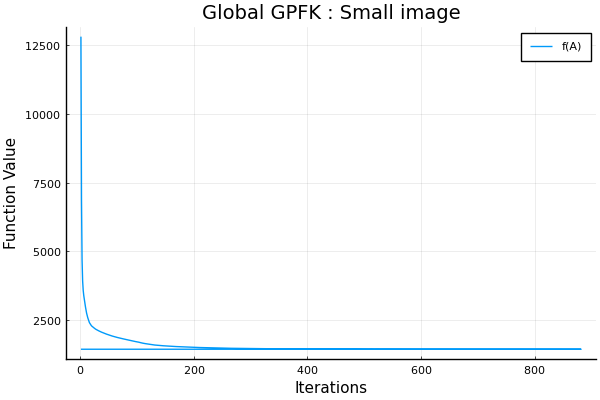

In [81]:
plot(1:nb_iter, f_values, label="f(A)", xlabel="Iterations", ylabel="Function Value")
title!("Global GPFK : Small image")

Starting from iteration 300, there is no further minimization. The curve becomes flat afterward

##### Full Image

In [82]:
nb_iter_max = 1000
α = 2/Lipschitz
max_time = 5*60*1000
display_progress = true

@time begin
    nb_iter , A_opt1 ,f_values  = GPFK(X_f,S,f,∇f,ϵ_mat_f,nb_iter_max ,A_init_f , α , display_progress , max_time )
end


Iteration : 100 | f(A) = 22585.794286339835
Iteration : 200 | f(A) = 20659.21430674653
157.882487 seconds (1.24 G allocations: 176.558 GiB, 12.44% gc time)


(205, [0.06637972068484702 0.062094408618427605 … 0.012870623734940625 0.0; 0.548719489088829 0.5774563249854351 … 0.09738384857147457 0.0; 0.0 0.0 … 0.8929268378420967 1.0006038361247995; 0.38972969298742866 0.366766178125793 … 0.0 0.0], [164299.43131334038, 89231.5491147227, 60255.46889491462, 51938.2182151173, 49591.279483096194, 48407.71077980981, 47241.48513636969, 46010.95904694898, 44703.45220900155, 43319.45539995775  …  20693.22088007679, 20684.912541266443, 20675.982461913038, 20667.992664435184, 20659.21430674653, 20648.999566133276, 20641.597969731265, 20633.312490707947, 20625.083186603882, 20618.10235880778], [173.23535209133786])

In [83]:
println("Optimal value ",f(X_f,S,A_opt1))

Optimal value 20618.10235880778


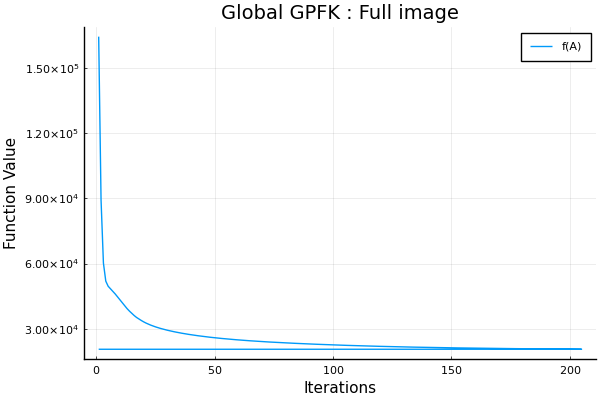

In [84]:
plot(1:nb_iter, f_values, label="f(A)", xlabel="Iterations", ylabel="Function Value")
title!("Global GPFK : Full image")

##### Comparison between Small and Large Images
Although the large image is 9 times the size of the small image, the convergence time is not 9 times greater. The algorithm took 68 seconds to converge for the small image and 205 seconds for the large image. This is expected, as the second algorithm converged after 205 iterations instead of 882 iterations for the first one (this is controlled by the approximation of the convergence criterion we use).

Similarly, the memory usage is 1.2 GB for the large image, compared to 597 MB for the small image. This isn't 9 times larger, but approximately 2 times the memory usage. the memory doesn’t scale linearly because intermediate computations (such as gradient steps and projections) reuse memory more efficiently, resulting in roughly double the memory usage instead of nine times.



#### 2. Pixelwise Implementation



In [9]:
@everywhere function pixelwise_GPFK(X,S,f,∇f,ϵ,nb_iter_max ,A_init , α , progress , max_time)
    # Initialize the matrix for optimal solutions
    N_pixels = size(X)[2]
    A_opt = zeros(size(A_init))

    # Progress bar setup
    p = Progress(10, desc="Processing")  

    min_iter = nb_iter_max
    f_values = zeros(nb_iter_max+1)
    
    for i in 1:N_pixels 
        n_iter_pixel_i , A_opt_i , f_values_pixel_i  = GPFK(X[:,i] , S , f , ∇f , ϵ , nb_iter_max  , A_init[:,i] , α , false ,max_time)

        # Update minimum iterations and accumulate function values
        min_iter = min(min_iter ,n_iter_pixel_i )
        f_values[1:n_iter_pixel_i+1] =  f_values[1:n_iter_pixel_i+1] + f_values_pixel_i

        # Store the optimal solution for pixel i
        A_opt[:,i] =  A_opt_i

        # Update progress bar every 10% of pixels
        if (progress) && (i%(N_pixels ÷ 10) == 0) 
            next!(p) 
        end

    end
    return min_iter , A_opt , f_values
end

In [101]:
nb_iter_max = 1000
α = 2/Lipschitz
max_time = 3
display_progress = true


@time begin
    nb_iter , A_opt2 , f_values2 = pixelwise_GPFK(X_f,S,f,∇f,ϵ_col_f,nb_iter_max ,A_init_f , α , display_progress , max_time)
end

Processing 100%|█████████████████████████████████████████| Time: 0:01:42


102.989587 seconds (1.17 G allocations: 153.202 GiB, 14.00% gc time, 0.07% compilation time)


(1, [0.07132546576005606 0.07226001952352439 … 0.02784697317971373 0.0; 0.5262838400312004 0.5313415361554958 … 0.0 0.0; 0.0 0.0 … 0.9732817318857786 1.0002538433456185; 0.4071418531156315 0.40255555856543557 … 0.0 0.0], [164299.43131333715, 89231.54911472183, 60230.94311062138, 51896.61825160678, 49524.69567174252, 48328.21327465428, 47150.5476165319, 45898.43610668396, 44569.866526994214, 43137.53623968027  …  2.3806501066157626, 2.391869060461154, 2.379299283818164, 2.3912499252233683, 2.3791221767971127, 2.399438228112832, 2.373080938964085, 2.3980874053152337, 2.3724618037262992, 2.397910298294182])

In [102]:
println("Optimal value ",f(X_f,S,A_opt2))

Optimal value 20818.370523475507


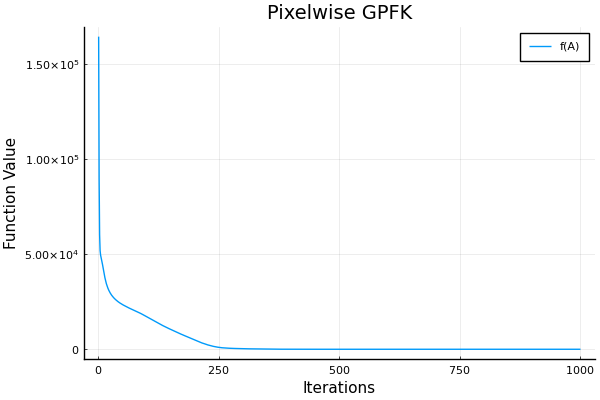

In [105]:
plot( f_values2, label="f(A)", xlabel="Iterations", ylabel="Function Value")
title!("Pixelwise GPFK" )

 Comparison between Pixelwise Implementation and General Implementation

 
Solving the problem for each pixel separately in a sequential manner has significantly accelerated execution, cutting the runtime in half. This is because not all computations are linearly complex, resulting in a much smaller execution time.

Regarding the final objective function value, the pixelwise implementation returns a higher value (calculated as 100 * 200 / 20618). However, the difference is minimal.



#### 3. Parallelized Implementation


In [26]:
@everywhere using LinearAlgebra

function GPFK_parallel(patch_size, X, S, f, ∇f, ϵ, nb_iter_max, A_init, α, progress, max_time)
    # Get the number of columns in X
    N = size(X, 2)
    n_workers = length(workers())
    f_values = zeros(nb_iter_max)



    # Calculate the number of patches and create progress bar
    n_patches = ceil(Int, N / patch_size)
    p = Progress(n_patches, desc="Processing")  

    # Preallocate results container
    results = Vector{Future}(undef, n_patches)  

    # Loop over the patches and assign them to workers in a round-robin fashion
    idx = 1
    for start_idx in 1:patch_size:N
        w = workers()[(idx - 1) % n_workers + 1]
        end_idx = min(start_idx + patch_size - 1, N)

        # Assign the computation for the current patch to the selected worker
        results[idx] = @spawnat w GPFK(X[:, start_idx:end_idx], S, f, ∇f, ϵ, nb_iter_max, A_init[:, start_idx:end_idx], α, false, max_time)

        # Update progress
        if progress
            next!(p)
        end
        idx += 1
    end

    # Collect results from the workers
    A = hcat([fetch(r)[2] for r in results]...)  # Only extract the second element (A1) of each result.
    
    # Optionally, you could collect f_values too if needed, but it's not currently used.
    for r in results
        nb_iter , f_values_i = fetch(r)[1] , fetch(r)[3]
       f_values[1:nb_iter+1] =  f_values[1:nb_iter+1] + f_values_i
    end
    return A, f_values
end


GPFK_parallel (generic function with 1 method)

In [13]:
function test_worker_configurations(X, S, f, ∇f, ϵ, nb_iter_max, A_init, α, progress, max_time)
    # Define the worker configurations to test
    worker_configs = 4:8  # Number of workers from 4 to 8
    N = size(X,2)
    results = []  # To store the results for each configuration

    # Loop over all combinations of workers and patch sizes
    for n_workers in worker_configs
        addprocs(n_workers- nprocs()-1)  # Dynamically add workers for the current test
        patch_size_range = range(5000, stop=floor(N ÷ n_workers), length=4)
        patch_size_range = floor.(Int, patch_size_range)
        for patch_size in patch_size_range

            n_patches=ceil(Int, N / patch_size)
            ϵ_new = ϵ /sqrt(n_patches)

            println("Running with $n_workers workers and patch_size $patch_size")
            elapsed_time = @elapsed begin
                A, f_values = GPFK_parallel(patch_size, X, S, f, ∇f, ϵ_new, nb_iter_max, A_init, α, progress, max_time)
            end
            # Store results for analysis
            push!(results, (n_workers, patch_size, A, f_values, elapsed_time))

        end
    end

    return results
end


test_worker_configurations (generic function with 1 method)

In [56]:
nb_iter_max = 1000
α = 2/Lipschitz
max_time = 300
progress = true

results = test_worker_configurations(X_f, S, f, ∇f, ϵ_mat_f, nb_iter_max, A_init_f, α, progress, max_time)

Running with 4 workers and patch_size 5000


Processing 100%|█████████████████████████████████████████| Time: 0:00:06


Running with 4 workers and patch_size 10833


Processing 100%|█████████████████████████████████████████| Time: 0:00:04


Running with 4 workers and patch_size 16666


Processing 100%|█████████████████████████████████████████| Time: 0:00:02


Running with 4 workers and patch_size 22500


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 5 workers and patch_size 5000


Processing 100%|█████████████████████████████████████████| Time: 0:00:06


Running with 5 workers and patch_size 9333


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 5 workers and patch_size 13666


Processing 100%|█████████████████████████████████████████| Time: 0:00:02


Running with 5 workers and patch_size 18000


Processing 100%|█████████████████████████████████████████| Time: 0:00:02


Running with 6 workers and patch_size 5000


Processing 100%|█████████████████████████████████████████| Time: 0:00:05


Running with 6 workers and patch_size 8333


Processing 100%|█████████████████████████████████████████| Time: 0:00:04


Running with 6 workers and patch_size 11666


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 6 workers and patch_size 15000


Processing 100%|█████████████████████████████████████████| Time: 0:00:02


Running with 7 workers and patch_size 5000


Processing 100%|█████████████████████████████████████████| Time: 0:00:06


Running with 7 workers and patch_size 7619


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 7 workers and patch_size 10238


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 7 workers and patch_size 12857


Processing 100%|█████████████████████████████████████████| Time: 0:00:02


Running with 8 workers and patch_size 5000


Processing 100%|█████████████████████████████████████████| Time: 0:00:05


Running with 8 workers and patch_size 7083


Processing 100%|█████████████████████████████████████████| Time: 0:00:04


Running with 8 workers and patch_size 9166


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


Running with 8 workers and patch_size 11250


Processing 100%|█████████████████████████████████████████| Time: 0:00:03


20-element Vector{Any}:
 (4, 5000, [0.1390804454654464 0.09439286170080158 … 0.07679858826885842 0.08374302406112318; 0.3575213289094763 0.35569852481686176 … 0.30474447122650755 0.23625643498543347; 0.15388392977639007 0.27710519699189834 … 0.35432365632482254 0.27914650363529353; 0.34951429584868726 0.2728034164904385 … 0.2641332841798114 0.40085403731814995], [164155.24515502498, 89207.0173916173, 57952.8748974027, 45135.49202826994, 33362.83040104519, 32526.95508760684, 21034.125655916156, 13947.905510742134, 6011.994739168136, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], 6.9124341)
 (4, 10833, [0.15859596247143481 0.09325832440433829 … 0.007882734463847928 0.0; 0.35192385176108526 0.35298435753593993 … 0.311567798090737 0.24674722371354352; 0.15088334098260367 0.2833414358545115 … 0.42378599159489094 0.36513001115933824; 0.3385968447848762 0.2704158822052102 … 0.25676347585052406 0.3888907516407385], [164155.2451550267, 89207.01739161792, 60249.69882894088, 47722.426

Plot for execution_time = f(patch_size)

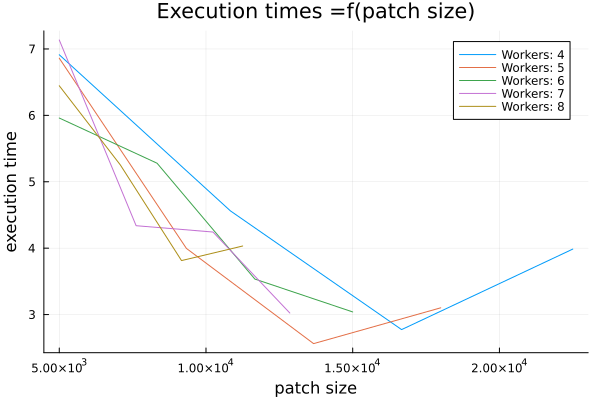

In [27]:
gr()  # Configure GR comme backend par défaut


executions_times = []
patch_sizes = []
list_nb_workers = 4:8
for nb_workers in list_nb_workers
    patch_size_range = range(5000, stop=floor(N_f ÷ nb_workers), length=4)
    patch_size_range = floor.(Int, patch_size_range)
    push!(patch_sizes ,(nb_workers ,patch_size_range ))
    times = [result[5] for result in results if result[1]==nb_workers]
    push!(executions_times ,(nb_workers ,times))
end



p = plot(title="Execution times =f(patch size)", xlabel="patch size", ylabel="execution time")
for i in 1:5
    plot!(p,patch_sizes[i][2],executions_times[i][2],label="Workers: $(executions_times[i][1])")
end


display(p)




- Apart from the curve for 6 workers, the execution time decreases as the patch size increases, up to $N_{\text{pixels}} / n_{\text{workers}}$. Beyond this point, it starts increasing, but for 6 workers, the execution time consistently decreases.

- In general, parallel computation significantly reduced the execution time. Even for the worst combination of $n_{\text{workers}}$ and $ \text{patch size} $, the execution time is only **7 seconds**, compared to **102 seconds** for the sequential column-wise computation and **158 seconds** for the general GPFK.

- The best combination is $n_{\text{workers}} = 5$ and $ \text{patch size} = 13666$.

- Increasing the number of workers does not always result in better performance.Adding too many workers can lead to resource saturation, such as memory or CPU, slowing down calculations due to the overhead of managing parallel tasks. When the number of workers exceeds the system's capacity, each additional worker can increase the overall execution time. Additionally, parallel computing often requires data exchanges between workers. If these communications become too frequent or complex, they can negate the benefits of parallelization, especially in systems with limited resources or slow connections.
